In [36]:
# Set up
%pylab
%pylab inline
%matplotlib inline
%load_ext autoreload
%autoreload 2
import tqdm
import random
import pandas as pd
from collections import Counter
from itertools import cycle

from sklearn import datasets, metrics, tree
from sklearn.cluster import KMeans, MiniBatchKMeans, Birch, DBSCAN
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split

import spectral
import seaborn as sns 
import tqdm
import copy 

import DecisionTree

Using matplotlib backend: TkAgg
Populating the interactive namespace from numpy and matplotlib
Populating the interactive namespace from numpy and matplotlib
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
def get_tree_error(tree, df):
    res = []
    for i in range(len(df)):
        res.append(tree.classify(df.iloc[i]))
        
    classes = pd.Series(np.array(df['target']) == np.array(res)
                    ).value_counts()
    
    if not False in classes:
        return 0
    
    return classes[False] / len(df) * 100

In [37]:
bank_df = pd.read_csv('data/bank.csv', sep=';')
bank_df.rename(columns={'y' : 'target'}, inplace=True)
bank_full_df = pd.read_csv('data/bank-full.csv', sep=';')
bank_full_df.rename(columns={'y' : 'target'}, inplace=True)

bank_add_df = pd.read_csv('data/bank-additional.csv', sep=';')
bank_add_df.rename(columns={'y' : 'target'}, inplace=True)
bank_add_full_df = pd.read_csv('data/bank-additional-full.csv', sep=';')
bank_add_full_df.rename(columns={'y' : 'target'}, inplace=True)

In [4]:
bank_full_df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,target
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no


In [5]:
bank_full_df.describe()

,age,balance,day,duration,campaign,pdays,previous
count,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000
mean,40.936210,1362.272058,15.806419,258.163080,2.763841,40.197828,0.580323
std,10.618762,3044.765829,8.322476,257.527812,3.098021,100.128746,2.303441
min,18.000000,-8019.000000,1.000000,0.000000,1.000000,-1.000000,0.000000
25%,33.000000,72.000000,8.000000,103.000000,1.000000,-1.000000,0.000000
50%,39.000000,448.000000,16.000000,180.000000,2.000000,-1.000000,0.000000
75%,48.000000,1428.000000,21.000000,319.000000,3.000000,-1.000000,0.000000
max,95.000000,102127.000000,31.000000,4918.000000,63.000000,871.000000,275.000000


In [6]:
bank_add_df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,target
0,30,blue-collar,married,basic.9y,no,yes,no,cellular,may,fri,...,2,999,0,nonexistent,-1.8,92.893,-46.2,1.313,5099.1,no
1,39,services,single,high.school,no,no,no,telephone,may,fri,...,4,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
2,25,services,married,high.school,no,yes,no,telephone,jun,wed,...,1,999,0,nonexistent,1.4,94.465,-41.8,4.962,5228.1,no
3,38,services,married,basic.9y,no,unknown,unknown,telephone,jun,fri,...,3,999,0,nonexistent,1.4,94.465,-41.8,4.959,5228.1,no
4,47,admin.,married,university.degree,no,yes,no,cellular,nov,mon,...,1,999,0,nonexistent,-0.1,93.200,-42.0,4.191,5195.8,no


# 1. Bank df

In [7]:
bank_train, bank_test = train_test_split(bank_df, test_size=0.33)

In [8]:
%%time
bank_tree_gini = DecisionTree.Tree(bank_train, criterion='gini')

Wall time: 1min 2s


In [9]:
%%time
bank_tree_entropy = DecisionTree.Tree(bank_train, criterion='infogain')

Wall time: 59.9 s


In [53]:
print(f'Err for gini {get_tree_error(bank_tree_gini, bank_test):.3f}%')
print(f'Err for entropy {get_tree_error(bank_tree_entropy, bank_test):.3f}%')

Err for gini 14.611%
Err for entropy 14.008%


In [48]:
predicts_gini, predicts_entropy = [], []
for i in range(len(bank_test)):
    predicts_gini.append(bank_tree_gini.classify(bank_test.iloc[i]))
    predicts_entropy.append(bank_tree_entropy.classify(bank_test.iloc[i]))

print('Confusion matrix for gini')
metrics.confusion_matrix(np.array(predicts_gini), bank_test['target'])

Confusion matrix for gini


array([[1205,  119],
       [  99,   69]], dtype=int64)

In [50]:
print('Confusion matrix for entropy')
metrics.confusion_matrix(np.array(predicts_entropy), bank_test['target'])

Confusion matrix for entropy


array([[1202,  107],
       [ 102,   81]], dtype=int64)

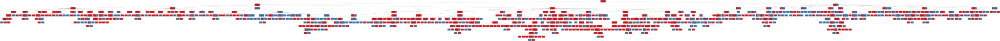

In [11]:
bank_tree_gini.draw()

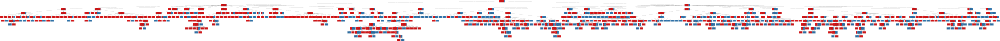

In [12]:
bank_tree_entropy.draw()

In [13]:
prunned_bank_tree_gini = copy.deepcopy(bank_tree_gini)
prunned_bank_tree_entropy = copy.deepcopy(bank_tree_entropy)

prunned_bank_tree_gini.prune_with_confidence_interval()
prunned_bank_tree_entropy.prune_with_confidence_interval()
print(f'Err for prunned gini {get_tree_error(prunned_bank_tree_gini, bank_test)}%')
print(f'Err for prunned entropy {get_tree_error(prunned_bank_tree_entropy, bank_test)}%')

Err for prunned gini 12.600536193029491%
Err for prunned entropy 12.600536193029491%


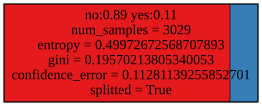

In [14]:
prunned_bank_tree_gini.draw()

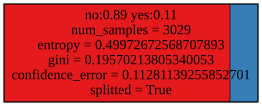

In [15]:
prunned_bank_tree_entropy.draw()

# 2. Bank_add_df

In [16]:
bank_add_train, bank_add_test = train_test_split(bank_add_df, test_size=0.33)

In [17]:
%%time
bank_add_tree_gini = DecisionTree.Tree(bank_add_train, criterion='gini')

Wall time: 1min


In [18]:
%%time
bank_add_tree_entropy = DecisionTree.Tree(bank_add_train, criterion='infogain')

Wall time: 1min 1s


In [19]:
print(f'Err for gini {get_tree_error(bank_add_tree_gini, bank_add_test)}%')
print(f'Err for entropy {get_tree_error(bank_add_tree_entropy, bank_add_test)}%')

Err for gini 11.323529411764707%
Err for entropy 10.735294117647058%


In [57]:
predicts_gini, predicts_entropy = [], []
for i in range(len(bank_add_test)):
    predicts_gini.append(bank_add_tree_gini.classify(bank_add_test.iloc[i]))
    predicts_entropy.append(bank_add_tree_entropy.classify(bank_add_test.iloc[i]))

print('Confusion matrix for gini')
metrics.confusion_matrix(np.array(predicts_gini), bank_add_test['target'])

Confusion matrix for gini


array([[1139,   76],
       [  78,   67]], dtype=int64)

In [56]:
print('Confusion matrix for entropy')
metrics.confusion_matrix(np.array(predicts_entropy), bank_add_test['target'])

Confusion matrix for entropy


array([[1148,   77],
       [  69,   66]], dtype=int64)

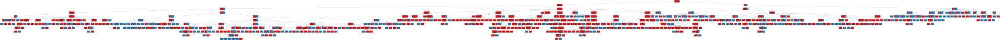

In [20]:
bank_add_tree_gini.draw()

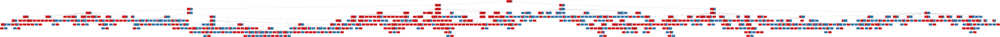

In [21]:
bank_add_tree_entropy.draw()

In [22]:
prunned_bank_add_tree_gini = copy.deepcopy(bank_add_tree_gini)
prunned_bank_add_tree_entropy = copy.deepcopy(bank_add_tree_entropy)

prunned_bank_add_tree_gini.prune_with_confidence_interval()
prunned_bank_add_tree_entropy.prune_with_confidence_interval()
print(f'Err for prunned gini {get_tree_error(prunned_bank_add_tree_gini, bank_add_test)}%')
print(f'Err for prunned entropy {get_tree_error(prunned_bank_add_tree_entropy, bank_add_test)}%')

Err for prunned gini 10.514705882352942%
Err for prunned entropy 10.514705882352942%


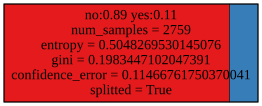

In [23]:
prunned_bank_add_tree_gini.draw()

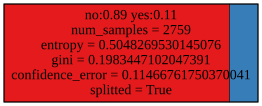

In [24]:
prunned_bank_add_tree_entropy.draw()

In [25]:
bank_add_full_train, bank_add__full_test = train_test_split(bank_add_full_df, test_size=0.33)

In [26]:
%%time
bank_add_full_tree_gini = DecisionTree.Tree(bank_add_full_train, criterion='gini')

Wall time: 12min 8s


In [27]:
%%time
bank_add__full_tree_entropy = DecisionTree.Tree(bank_add_full_train, criterion='infogain')

Wall time: 10min 38s


In [58]:
print(f'Err for gini {get_tree_error(bank_add_full_tree_gini, bank_add__full_test):.3f}%')
print(f'Err for entropy {get_tree_error(bank_add__full_tree_entropy, bank_add__full_test):.3f}%')

Err for gini 11.160%
Err for entropy 11.248%


In [59]:
predicts_gini, predicts_entropy = [], []
for i in range(len(bank_add__full_test)):
    predicts_gini.append(bank_add_full_tree_gini.classify(bank_add__full_test.iloc[i]))
    predicts_entropy.append(bank_add__full_tree_entropy.classify(bank_add__full_test.iloc[i]))

print('Confusion matrix for gini')
metrics.confusion_matrix(np.array(predicts_gini), bank_add__full_test['target'])

Confusion matrix for gini


array([[11306,   746],
       [  771,   770]], dtype=int64)

In [60]:
print('Confusion matrix for entropy')
metrics.confusion_matrix(np.array(predicts_entropy), bank_add__full_test['target'])

Confusion matrix for entropy


array([[11309,   761],
       [  768,   755]], dtype=int64)

In [29]:
bank_add_full_tree_gini.draw()

In [30]:
bank_add__full_tree_entropy.draw()

In [31]:
prunned_bank_add_full_tree_gini = copy.deepcopy(bank_add_full_tree_gini)
prunned_bank_add_full_tree_entropy = copy.deepcopy(bank_add__full_tree_entropy)

prunned_bank_add_full_tree_gini.prune_with_confidence_interval()
prunned_bank_add_full_tree_entropy.prune_with_confidence_interval()
print(f'Err for prunned gini {get_tree_error(prunned_bank_add_full_tree_gini, bank_add_test)}%')
print(f'Err for prunned entropy {get_tree_error(prunned_bank_add_full_tree_entropy, bank_add_test)}%')

Err for prunned gini 10.514705882352942%
Err for prunned entropy 10.514705882352942%


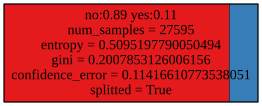

In [32]:
prunned_bank_add_full_tree_gini.draw()

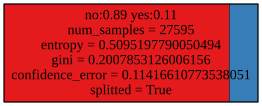

In [33]:
prunned_bank_add_full_tree_entropy.draw()